In [1]:
from cnmf import cNMF
import numpy as np
import pandas as pd
import os
import scanpy as sc

import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn

# Assemble cNMF data
Following tutorial from: https://github.com/dylkot/cNMF

Use the bash script instead for submitting jobs to LSF. Specifically, cnma prepare and cnmf factorize needs to be run with 2_runcNMF.sh, matching the results folders.

In [2]:
# Specify cNMF output folder
cnmf_obj = cNMF(output_dir="./results", name="megagutintestine_cNMF_v2")

In [3]:
# Combine results across k values tested
cnmf_obj.combine(skip_missing_files=True)

Combining factorizations for k=5.
Combining factorizations for k=6.
Combining factorizations for k=7.
Combining factorizations for k=8.
Combining factorizations for k=9.
Combining factorizations for k=10.
Combining factorizations for k=11.
Combining factorizations for k=12.
Combining factorizations for k=13.
Combining factorizations for k=14.
Combining factorizations for k=15.
Combining factorizations for k=16.
Combining factorizations for k=17.
Combining factorizations for k=18.
Combining factorizations for k=19.
Combining factorizations for k=20.
Combining factorizations for k=21.
Combining factorizations for k=22.
Combining factorizations for k=23.
Combining factorizations for k=24.
Combining factorizations for k=25.
Combining factorizations for k=26.
Combining factorizations for k=27.
Combining factorizations for k=28.
Combining factorizations for k=29.
Combining factorizations for k=30.
Combining factorizations for k=31.
Combining factorizations for k=32.
Combining factorizations 

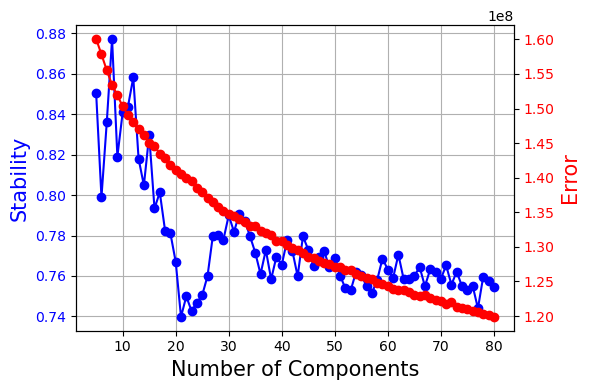

In [4]:
# Plot stability-error tradeoff to help assess number of components k
cnmf_obj.k_selection_plot(close_fig=False)

## Determine number of components, k

In [5]:
# select optimal k
#k = 27
k = 44
#k = 62

/home/jovyan/my-conda-envs/ni_env2/lib/python3.10/site-packages/cnmf/cnmf.py:772: RuntimeWarning: invalid value encountered in divide
  norm_tpm = (np.array(tpm.X.todense()) - tpm_stats['__mean'].values) / tpm_stats['__std'].values
/home/jovyan/my-conda-envs/ni_env2/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


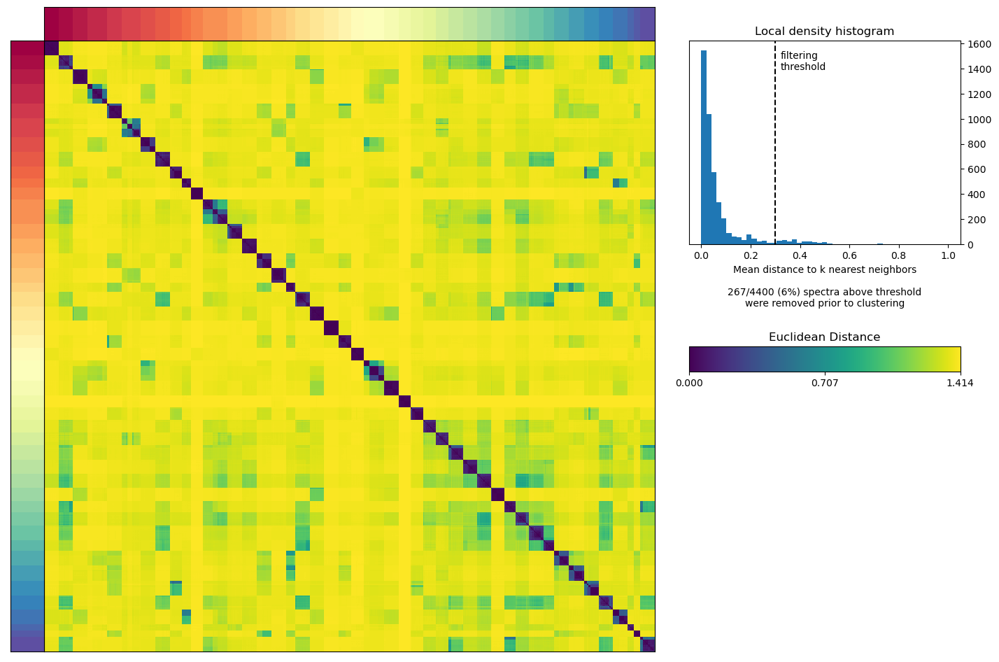

In [6]:
# Plot consistency of cNMF components by clustering consensus estimates for gene programs
cnmf_obj.consensus(k=k, density_threshold=0.3)

In [7]:
# Extract data for given k
usage, spectra_scores, spectra_tpm, top_genes = cnmf_obj.load_results(K=k, density_threshold=0.3)

In [8]:
#usage

In [9]:
#spectra_scores

In [10]:
# pd.set_option('display.max_rows', 50)
# top_genes

In [11]:
# Write top-100 genes to table
top_genes.to_csv("results/cNMF_k" + str(k) + "_top_genes.csv", index=False)

In [12]:
spectra_scores

,1,2,3,4,5,6,7,8,9,10,...,35,36,37,38,39,40,41,42,43,44
AL627309.1,-0.000139,-0.000176,-0.000170,-0.000063,0.000005,-0.000060,-0.000047,-7.228615e-06,0.000058,0.000131,...,0.000310,6.587389e-07,0.000243,0.000071,0.000056,0.000008,-0.000035,0.000006,-0.000045,0.000014
FAM87B,-0.000152,-0.000071,-0.000097,-0.000063,-0.000017,0.000081,-0.000106,-6.946445e-06,-0.000010,-0.000016,...,-0.000024,4.188026e-05,-0.000187,0.000122,0.000046,-0.000011,-0.000056,-0.000015,-0.000024,0.000059
LINC00115,-0.000080,0.000055,-0.000155,-0.000118,-0.000035,-0.000193,0.000327,1.989966e-05,-0.000015,-0.000005,...,-0.000109,-3.263864e-06,-0.000071,-0.000068,0.000012,-0.000033,0.000264,0.000029,0.000172,-0.000062
FAM41C,0.000084,-0.000041,0.001125,0.000480,-0.000027,0.000076,-0.000202,-4.427754e-05,-0.000043,-0.000077,...,0.000155,-1.385769e-04,-0.000116,0.000179,0.000007,-0.000078,0.000791,-0.000022,-0.000179,-0.000242
SAMD11,-0.000742,-0.000554,-0.000713,-0.000462,-0.000061,-0.000233,0.000841,-5.932293e-05,-0.000079,-0.000081,...,0.000563,-1.822545e-05,-0.000251,0.004355,0.000328,-0.000066,-0.000142,-0.000041,-0.000167,0.000034
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC145212.1,-0.000314,0.000051,-0.000249,0.000103,0.000024,0.000017,-0.000119,1.697345e-05,-0.000009,0.000018,...,0.000180,2.592289e-04,-0.000058,0.000028,0.000045,-0.000037,-0.000122,-0.000059,0.000432,-0.000103
AC011043.1,-0.000575,-0.000303,-0.000334,-0.000255,0.000068,-0.000138,-0.000119,4.873312e-07,0.000237,0.000069,...,0.000513,1.176686e-04,0.000635,0.000404,0.000331,0.000003,-0.000122,0.000049,0.000106,-0.000103
AC011841.1,-0.000194,-0.000129,-0.000158,-0.000091,0.000040,-0.000040,-0.000044,-7.996872e-06,0.000218,0.000114,...,0.000041,2.918270e-05,0.000047,-0.000025,0.000326,0.000135,0.000004,0.000029,0.000070,-0.000055
AL354822.1,-0.000417,0.000181,0.000369,0.000321,-0.000008,-0.000188,0.000072,5.533149e-06,-0.000038,-0.000003,...,0.000955,5.122700e-06,0.000877,0.000068,-0.000046,-0.000049,-0.000211,-0.000024,-0.000139,-0.000031


In [13]:
spectra_scores.to_csv("results/cNMF_k" + str(k) + "_spectra.csv")

# Joint analysis of cNMF usage matrix with anndata object

In [14]:
# Load raw data, containing cell barcode index
adata_raw = sc.read('h5ad/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.smallintestine.h5ad')

# Load anndata object, used for plotting UMAP and cell type annotations
#adata = sc.read_h5ad("../data/rna/scRNA_batch1_2.processed.fibroblasts.h5ad")

Only considering the two last: ['.smallintestine', '.h5ad'].
Only considering the two last: ['.smallintestine', '.h5ad'].


In [15]:
adata_raw.obs = pd.read_csv("h5ad/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.smallintestine.csv", index_col=0)

/home/jovyan/my-conda-envs/ni_env2/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3398: DtypeWarning: Columns (3,5,6,8,9,11,12,14,62,63,64,65,66,67,70,73,75,82,83,84,86,95,100,101,106,108,109,111,119,123,124,125,126,127,128,129,130,131,132) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [16]:
adata_raw

AnnData object with n_obs × n_vars = 99465 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

## Format cNMF usage rows and columns

In [17]:
# Rename usage columns prepending 'cNMF_'
usage.columns = ["cNMF_" + str(x) for x in usage.columns]

# convert from relative cell index to cell barcode
#usage.index = adata_raw.obs.index[usage.index]

#usage

In [18]:
usage

,cNMF_1,cNMF_2,cNMF_3,cNMF_4,cNMF_5,cNMF_6,cNMF_7,cNMF_8,cNMF_9,cNMF_10,...,cNMF_35,cNMF_36,cNMF_37,cNMF_38,cNMF_39,cNMF_40,cNMF_41,cNMF_42,cNMF_43,cNMF_44
index,,,,,,,,,,,,,,,,,,,,,
AAACCTGAGAGGTTAT-4918STDY7273964,0.055640,0.067680,0.736110,0.000000,0.024771,0.034714,0.000000,0.000000,0.011760,0.000000,...,0.000589,0.000000,0.002351,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000044
AAACCTGAGGCCCTCA-4918STDY7273964,0.113687,0.418870,0.120795,0.220819,0.020384,0.042608,0.001115,0.007048,0.000000,0.005469,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000279,0.000000
AAACCTGTCCAAACTG-4918STDY7273964,0.281185,0.310019,0.127140,0.000000,0.186025,0.066529,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000313
AAACGGGAGAGCTGGT-4918STDY7273964,0.025667,0.000000,0.923518,0.000000,0.000000,0.012970,0.000000,0.000054,0.000000,0.000000,...,0.009405,0.000000,0.001856,0.000040,0.000000,0.000000,0.000000,0.000000,0.000733,0.000192
AAACGGGCACTAAGTC-4918STDY7273964,0.099161,0.005582,0.769219,0.000000,0.000000,0.013566,0.007365,0.000000,0.000000,0.000000,...,0.000902,0.000000,0.000000,0.000474,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTATGCTCTTGCCGT-1_16-GI4401_DUO_EPI_GEX,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000565,0.000000,...,0.000000,0.000000,0.005102,0.000000,0.000000,0.000000,0.007069,0.000000,0.000000,0.000000
TTTCCTCCACGCCAGT-1_16-GI4401_DUO_EPI_GEX,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.027060,0.164906,0.000000,0.002092,...,0.003975,0.060423,0.024033,0.000000,0.000000,0.000000,0.000000,0.011692,0.015231,0.000000
TTTCCTCGTAGCGATG-1_16-GI4401_DUO_EPI_GEX,0.000000,0.068226,0.000000,0.000000,0.000000,0.099133,0.000000,0.000000,0.000000,0.011656,...,0.000000,0.036111,0.005540,0.000000,0.087936,0.003203,0.006197,0.000000,0.010261,0.004388


In [19]:
!mkdir -p data

In [20]:
# Write annotated and normalized cNMF usage
usage_annot = adata_raw.obs[['level_3_annot']].join(usage)
usage_annot.to_csv("results/cNMF_k" + str(k) + "_usage.csv")

In [21]:
# left join cNMF usage per cell
#adata.obs = adata.obs.join(usage)

In [22]:
adata_raw.obs = adata_raw.obs.join(usage)

In [23]:
adata_raw

AnnData object with n_obs × n_vars = 99465 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [24]:
adata_raw.obs.level_3_annot.value_counts()

Enterocyte                    12292
TA                             9047
Trm_CD4                        6659
B_naive                        6226
B_memory                       5426
                              ...  
Immune_recruiting_pericyte        5
Erythrocytes                      4
Eosinophil/basophil               2
Oesophagus_fibroblast             2
EC_cycling                        2
Name: level_3_annot, Length: 74, dtype: int64

In [25]:
#adata_raw.obs.fine_annot.value_counts()

In [26]:
# Store associated obs metadata separately
adata_raw.obs.to_csv("h5ad/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.smallintestine.cNMF.csv")

## Plots

In [27]:
color_palette={'EC_venous': '#2a4858',
  'Mast': '#826e91',
  'EC_capillary': '#855f9a',
  'DC_cDC1': '#8c543f',
  'Monocyte': '#5baf07',
  'DC_cDC2': '#cfdb65',
  'Basal': '#727271',
  'Treg_IL10': '#e5c510',
  'Crypt_fibroblast_PI16': '#bd7879',
  'Macrophage': '#486626',
  'Vascular_smooth_muscle': '#1E4147',
  'Lamina_propria_fibroblast_ADAMDEC1': '#e95e50',
  'Epithelial_cycling_G2M': '#ff3c4b',
  'Keratinocyte_stratified': '#EDD3E0',
  'Trm/em_CD8': '#256b87',
  'Pericyte': '#437356',
  'Oral_mucosa_fibroblast': '#303267',
  'Macrophage_MMP9': '#a5f002',
  'EC_lymphatic': '#999999',
  'Rectum_fibroblast': '#522e25',
  'Trm_Th17': '#1e093f',
  'DC_migratory': '#e6a519',
  'Epithelial_cycling_S': '#ff8433',
  'Trm_CD4': '#8107ed',
  'NK_CD16': '#0c1e0e',
  'Macrophage_LYVE1': '#8fd9d0',
  'Trm_CD8': '#2844c1',
  'Macrophage_TREM2': '#42c7ac',
  'Keratinocyte_inflammatory': '#E0AC9D',
  'Tnaive/cm_CD4': '#9c53bc',
  'DC_pDC': '#bdb197',
  'Villus_fibroblast_F3': '#d64582',
  'EC_arterial_2': '#ca6092',
  'EC_arterial_1': '#fa6e6e',
  'gdT': '#3fafb5',
  'B_memory': '#a33c22',
  'T/NK_cycling': '#c260ff',
  'Immune_recruiting_pericyte': '#AAC789',
  'MAIT': '#21b796',
  'ILC3': '#778c00',
  'Melanocyte': '#886F61',
  'Tfh_naive': '#5e3c55',
  'Keratinocyte_outer': '#BF7A9C',
  'EC_cycling': '#fac06e',
  'Tnaive/cm_CD8': '#5ca4ce',
  'NK_CD56bright': '#3f8c08',
  'B_naive': '#9b0319',
  'B_preB': '#8a4682',
  'Treg': '#f98261',
  'B_proB': '#d34794',
  'B_plasmablast': '#9e53db',
  'B_plasma_IgG': '#632f17',
  'Megakaryocyte/platelet': '#c730aa',
  'TA': '#b85f1c',
  'Mono/neutrophil_MPO': '#2a497a',
  'B_plasma_IgA1': '#f76c56',
  'Macrophage_CD5L': '#caf9cf',
  'Tfh': '#5e0b30',
  'Oesophagus_fibroblast': '#63A0C0',
  'B_plasma_IgA2': '#d6558d',
  'gdT_naive': '#26daf2',
  'B_GC_I': '#db9602',
  'B_plasma_IgM': '#c66d31',
  'DC_langerhans': '#c7a642',
  'Fibroblast_reticular': '#f0c134',
  'B_GC_II': '#e2d138',
  'Follicular_DC': '#f0982c',
  'Microfold': '#e55b85',
  'Enterocyte': '#e1b5e6',
  'Epithelial_stem': '#c924b9',
  'Surface_foveolar': '#d9b74a',
  'Mucous_gland_neck': '#f7b37c',
  'Cycling': '#ff8433',
  'Pareital': '#d45f80',
  'Enteroendocrine_MX': '#292663',
  'Myofibroblast': '#CCAE91',
  'Glial_2': '#0D6986',
  'Enteric_neural_crest_cycling': '#DBA507',
  'Enterochromaffin': '#22517a',
  'Chief': '#c95340',
  'Glial/Enteric_neural_crest': '#a8c545',
  'Enteroendocrine_G': '#2f3f4d',
  'Neuroblast': '#c50637',
  'Goblet_progenitor': '#e9f7ad',
  'Goblet': '#6c9939',
  'Enteroendocrine': '#68b7fc',
  'Erythrocytes': '#0e539c',
  'Enteroendocrine_X': '#7292ad',
  'Glial_3': '#053240',
  'Goblet_cycling': '#d1d14f',
  'BEST4_enterocyte_colonocyte': '#39997c',
  'Tuft': '#9d9dff',
  'Paneth': '#79508f',
  'Serous': '#C9DE55',
  'Mucous': '#67cc8e',
  'Duct': '#7D9100',
  'Seromucous': '#ACEBAE',
  'Myoepithelial': '#572300',
  'Ionocytes': '#9d9dff',
  'Colonocyte': '#d66245',
  'Mature_colonocyte': '#fa6161',
  'Mesoderm_2': '#b4793b',
  'Branch_A_inhibtory_motor_neuron': '#a39bcb',
  'SMC_PPLP2': '#d4d4e8',
  'Cycling_fibroblast': '#d65151',
  'ICC': '#69479b',
  'Branch_B_excitatory_motor_neuron': '#496695',
  'SMC_CAPN3': '#968dc6',
  'Mesoderm_1': '#663818',
  'Branch_B_primary_afferent_neuron': '#909134',
  'Proximal_progenitor_DUO/JEJ': '#fac219',
  'SMC_CAPN3_cycling': '#76738e',
  'Glial_1': '#8EC7D2',
  'Branch_A_primary_afferent_neuron': '#27bdbf',
  'Branch_A_interneuron': '#67608a',
  'NTS': '#baada4',
  'Proximal_progenitor_ILE': '#8f6e0d',
  'Enteroendocrine_progenitor': '#aeebdf',
  'Mesothelium': '#8F6592',
  'Distal_progenitor': '#dbc697',
  'Angiogenic_pericyte': '#308587',
  'Eosinophil/basophil': '#8b4eba',
  'CLDN10': '#706d65',
  'Distal_progenitor_PRAC1': '#8f8161',
  'Immature_pericyte': '#90c496',
  'Mesenchymal_LTO': '#f7eb59',
  'Gastric_fetal_epithelial': '#a01160',
  'DCS_MUC17_cycling': '#99216b',
  'DCS_MUC17': '#9c6b73',
  'Gland_basal': '#404040',
  'Gland_fetal': '#168039',
  'Basal_cycling': '#d1bf82',
  'Keratinocyte_fetal': '#d8306e',
  'Gland_duct': '#7D9100',
  'Gland_mucous': '#67cc8e',
  'Myoblast/myocyte': '#e2798d',
  'Unknown': '#000000'
}

In [28]:
# UMAP plots colored by cNMF usage
sc.set_figure_params(dpi_save=150, figsize=(8, 8))

# without outline
sc.pl.umap(
    adata_raw,
    color=['level_3_annot'] + usage.columns.to_list(),
    #palette='tab20',
    #palette=sc.plotting.palettes.godsnot_102,
    palette=color_palette,
    cmap='magma',
    frameon=False,
    vmax=1.0,
    vmin=0.0,
    size=15,  # point size
    save='_megagut_smallintestine_cNMF_usage.pdf'  # in ./figures
)

/home/jovyan/my-conda-envs/ni_env2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


         Falling back to preprocessing with `sc.pp.pca` and default params.


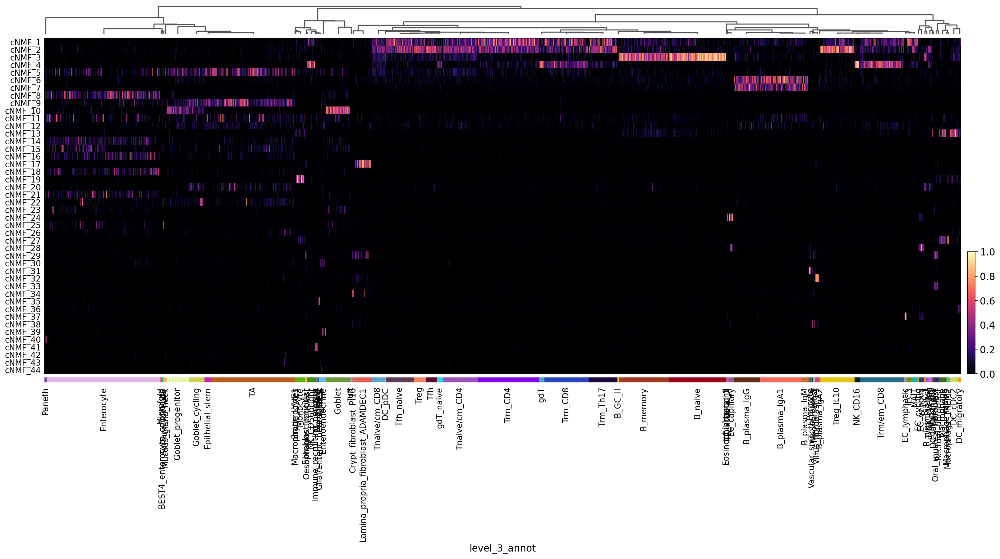

In [29]:
# Heatmap of cNMF usage by cell type
sc.set_figure_params(dpi_save=300)
sc.pl.heatmap(
    adata_raw,
    var_names=usage.columns,
    groupby='level_3_annot',
    dendrogram=True,
    swap_axes=True,
    cmap="magma",
    figsize=(24, 10),
    save="_megagut_smallintestine_cNMF_usage.pdf"
)

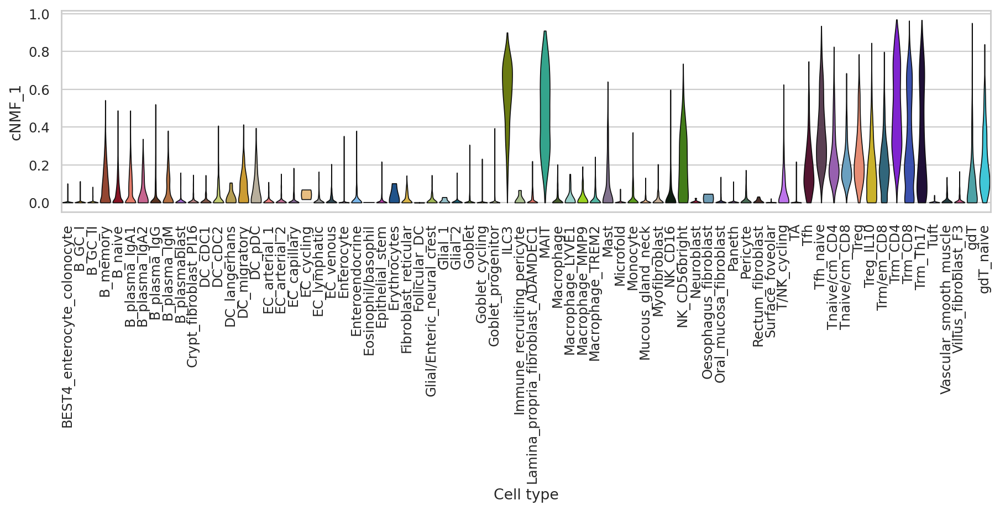

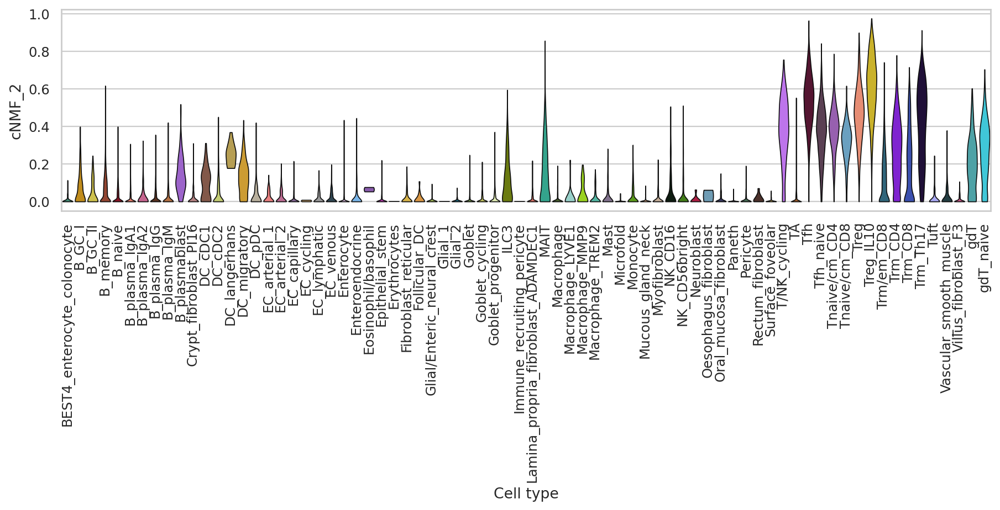

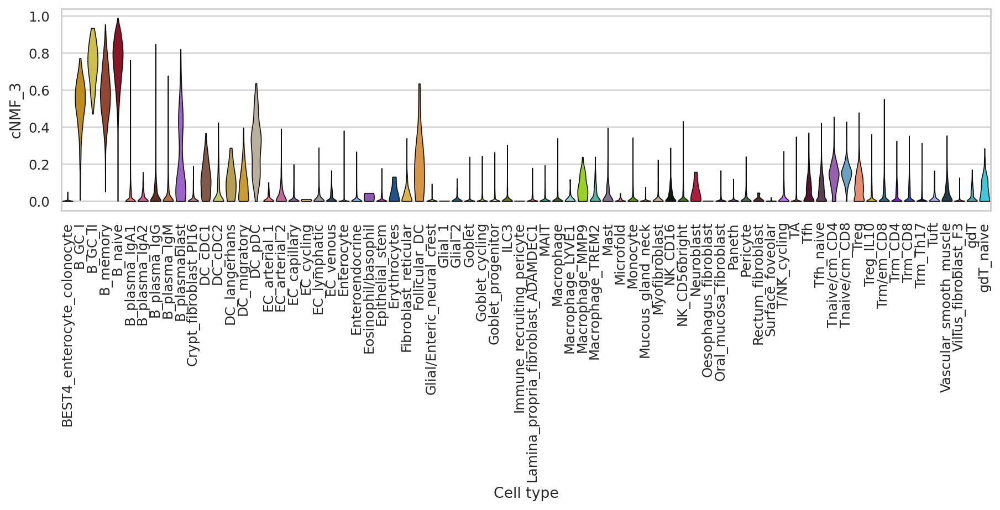

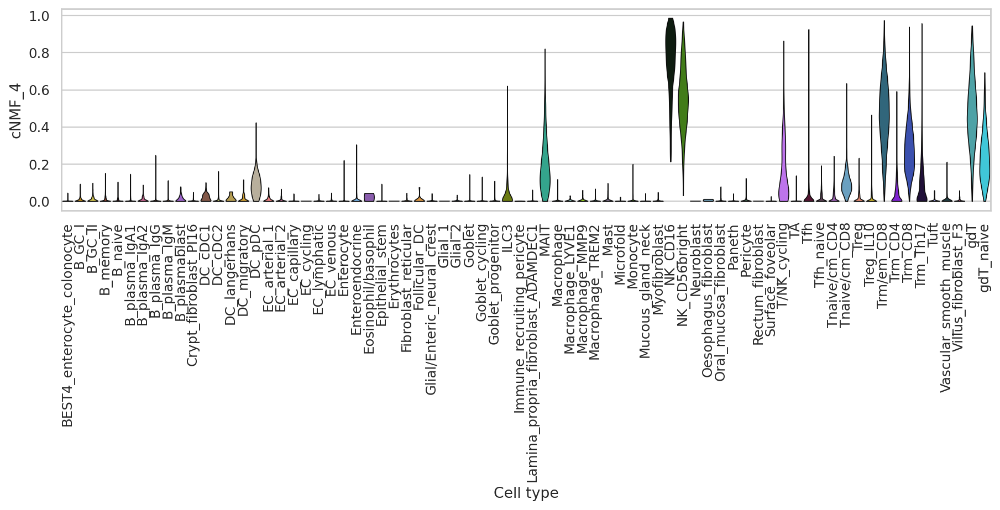

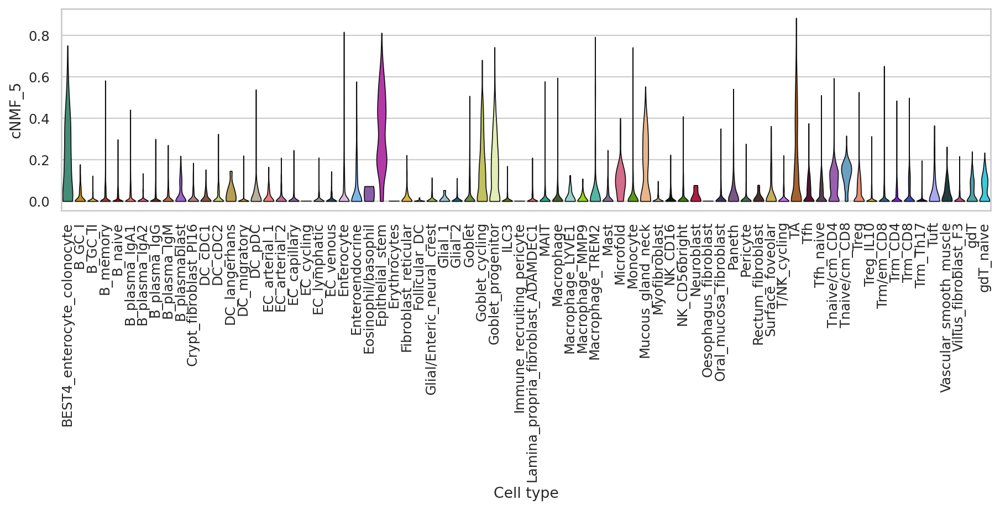

...

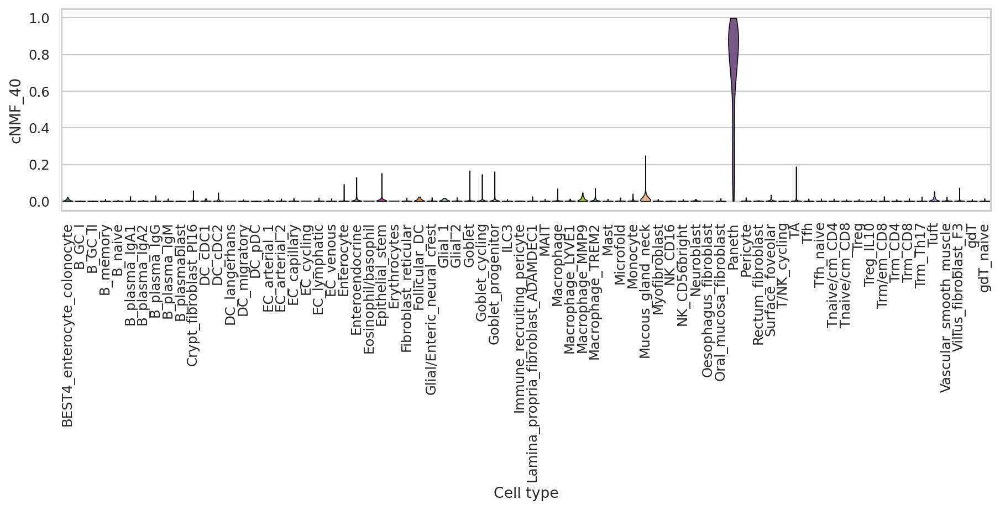

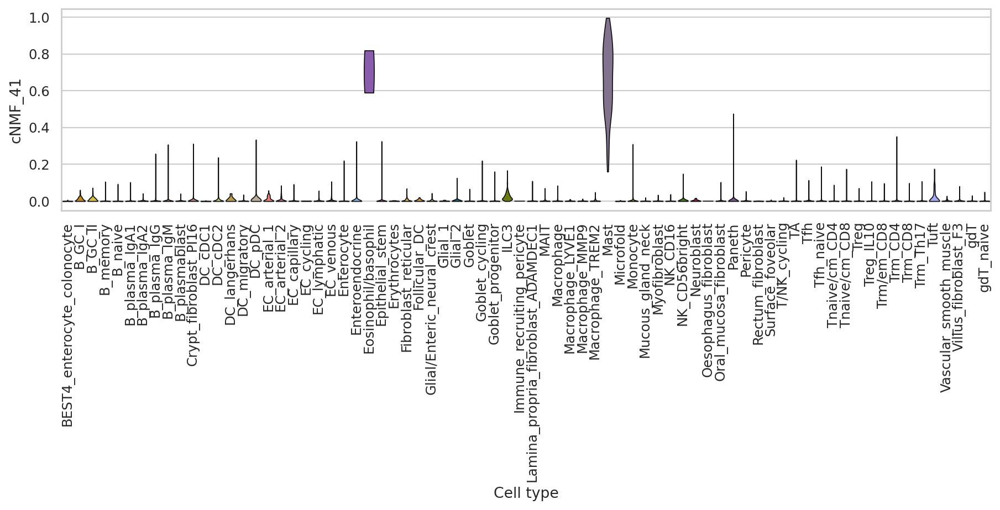

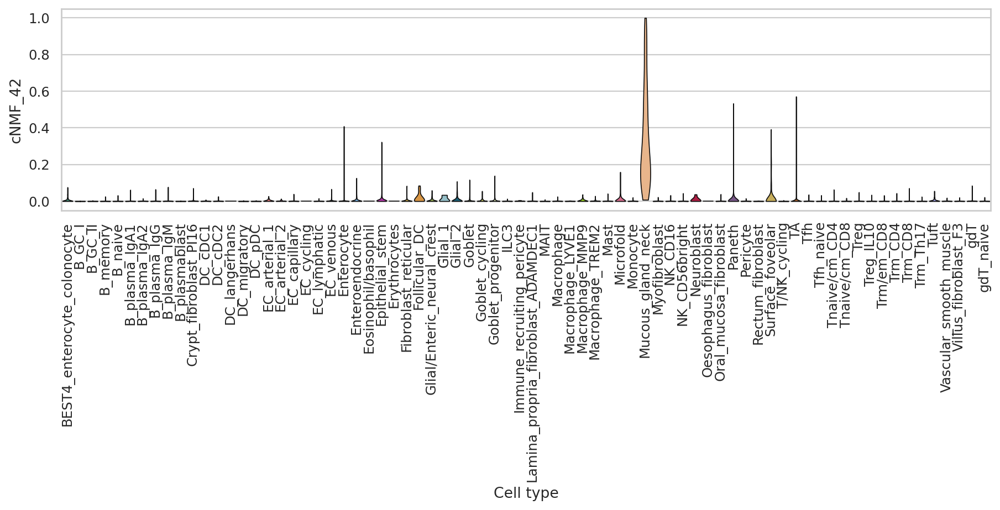

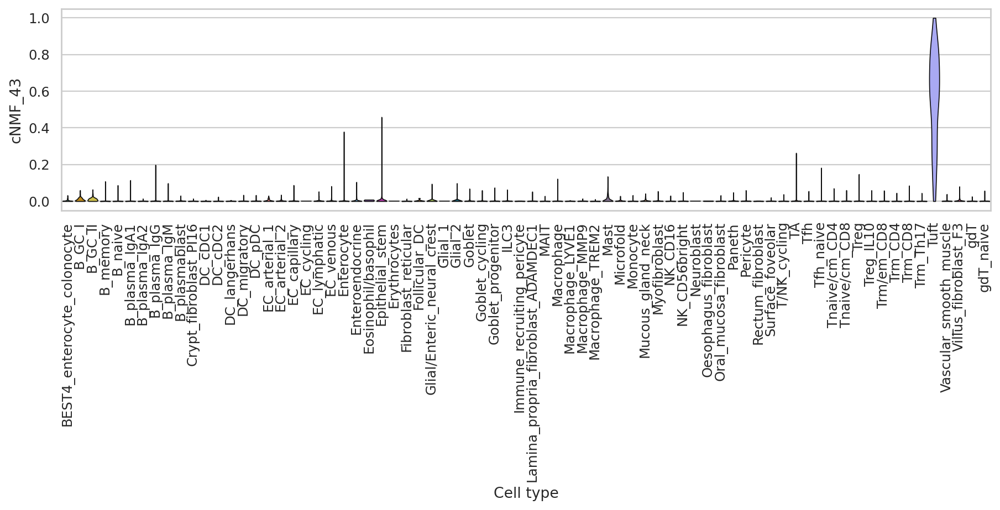

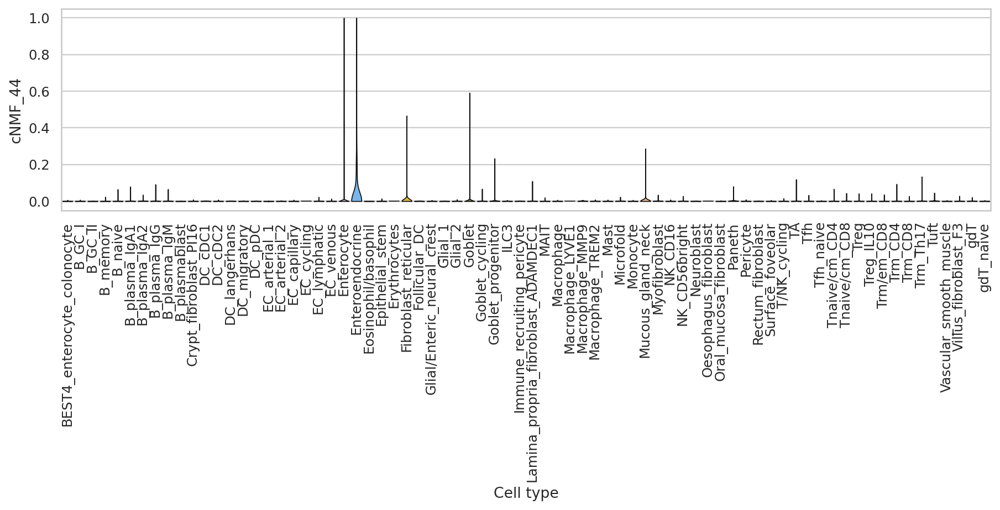

In [30]:
# Plot cell type violin plots for all cNMF factors
for i in range(1, k + 1):
    rcParams['figure.figsize'] = 11,3
    seaborn.set(style='whitegrid')
    sc.pl.violin(
        adata_raw,
        keys=['cNMF_' + str(i)],
        groupby='level_3_annot',
        xlabel='Cell type',
        rotation=90,
        linewidth=0.75,
        stripplot=False,
    )